# Fitting ellipses to James Webb Space Telescope's cartwheel galaxy images

In [1]:
import Pkg

# activate parent environment
Pkg.activate(normpath(joinpath(@__DIR__, ".")))
Pkg.resolve()
Pkg.instantiate()
Pkg.status()

using JuMP
using Clustering
using Images
using DSP
using Plots
using JuMP

  Activating project at `c:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  No Changes to `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Manifest.toml`


Status `C:\Users\lange\OneDrive - TU Eindhoven\master\2023-2024\2DME20 - NL optimization\project\2DME20-2023\project-2022-object-classification\Project.toml`
  [1e616198] COSMO v0.8.9
  [aaaa29a8] Clustering v0.15.7
  [5ae59095] Colors v0.13.0
  [717857b8] DSP v0.7.10
  [5789e2e9] FileIO v1.16.6
  [87dc4568] HiGHS v1.12.1
  [4e3cecfd] ImageShow v0.3.8
  [916415d5] Images v0.26.1
  [4076af6c] JuMP v1.23.5
⌃ [91a5bcdd] Plots v1.40.7
Info Packages marked with ⌃ have new versions available and may be upgradable.


## Read the image

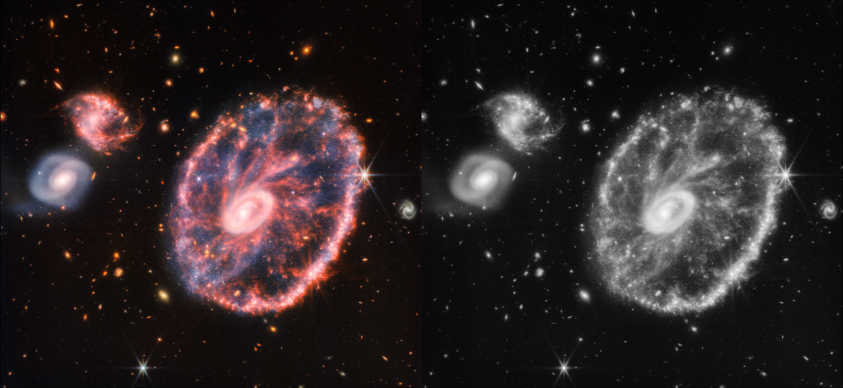

In [2]:
# read directory with images
directory_path = "."
image_path = joinpath(directory_path, "Cartwheel_Galaxy_JWST_NIRCam+MIRI.png")
image = load(image_path)

# convert to black and white (grayscale)
gray_image = Gray.(image)
mosaicview(image, gray_image; nrow=1)

In [3]:
# convert to array
image_array = Float64.(channelview(gray_image));

## Preprocess the image

In [4]:
# build the mexican hat filter
function mexican_hat_filter(n)
    filter = zeros(n, n)
    for i in 1:n
        for j in 1:n
            x = i - n / 2
            y = j - n / 2
            filter[i, j] = (1 - (x^2 + y^2) / (n^2)) * exp(-(x^2 + y^2) / (2 * n^2))
        end
    end
    return filter
end

mexican_hat_filter (generic function with 1 method)

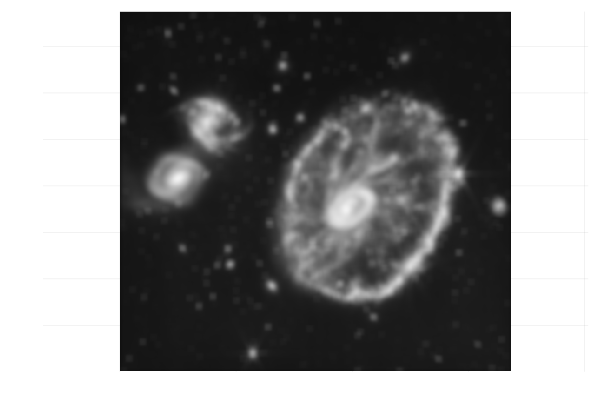

In [112]:
# apply the mexican hat filter
K = 16
mh_filter = mexican_hat_filter(K)

# apply the filter to the image by convolution
filt_img = DSP.conv(Matrix{Float64}(image_array), mh_filter)

# result is upside down, so we flip it
filt_img = filt_img[end:-1:1, :]

# cut off edges to make the image the same size as the original
N, M = size(filt_img)
filt_img = filt_img[Int(K / 2)+1:N-Int(K / 2), Int(K / 2)+1:M-Int(K / 2)]

# plot the filtered image
heatmap(filt_img, color=:grays, aspect_ratio=1, cbar=false, axis=false)

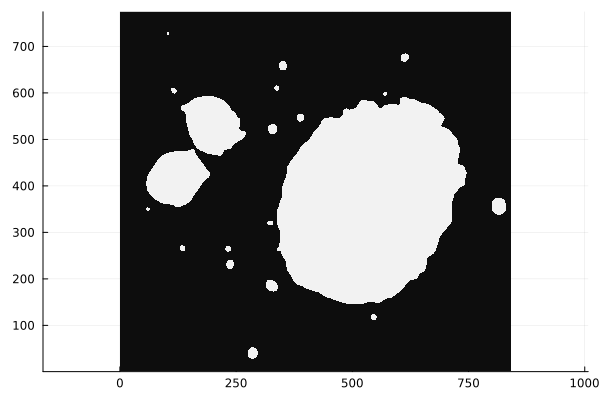

In [113]:
# apply thresholding to the filtered image
th_img = (filt_img .- minimum(filt_img)) / (maximum(filt_img) - minimum(filt_img))
th_img = Matrix{Bool}([th_img[i, j] > 0.26 ? 1.0 : 0.0 for i in 1:size(th_img, 1), j in 1:size(th_img, 2)])
th_img = clearborder(th_img, 10);

# fill image
th_img = Matrix{Bool}(1 .- th_img)
th_img = imfill(th_img, (0.0, 10000))
th_img = Matrix{Bool}(1 .- th_img)
heatmap(th_img, color=:grays, aspect_ratio=1, cbar=false)

In [114]:
function canny_edge_detector(f_smooth::Matrix{Float64}, d1::Float64=0.1, d2::Float64=0.1)
    # Dimensions of the image
    rows, cols = size(f_smooth)

    # Preallocate arrays for gradient and Laplacian
    gradient_magnitude = zeros(Float64, rows, cols)
    laplacian_magnitude = zeros(Float64, rows, cols)
    edge_matrix = zeros(Bool, rows, cols)  # Binary matrix for edges

    # Sobel filters
    sobel_x = [-1 0 1; -2 0 2; -1 0 1]
    sobel_y = [-1 -2 -1; 0 0 0; 1 2 1]
    sobel_xx = [-1 2 -1; 2 -4 2; -1 2 -1]
    sobel_yy = [-1 2 -1; 2 -4 2; -1 2 -1]

    # Convolve the image with the Sobel filters
    gradient_x = conv(f_smooth, sobel_x)
    gradient_y = conv(f_smooth, sobel_y)

    # Compute the gradient magnitude
    gradient_magnitude = sqrt.(gradient_x .^ 2 + gradient_y .^ 2)

    # second derivative
    gradient_xx = conv(f_smooth, sobel_xx)
    gradient_yy = conv(f_smooth, sobel_yy)
    laplacian_magnitude = sqrt.(gradient_xx .^ 2 + gradient_yy .^ 2)

    # thresholding with d1, d2
    for i in 1:rows
        for j in 1:cols
            if gradient_magnitude[i, j] > d1 && laplacian_magnitude[i, j] < d2
                edge_matrix[i, j] = true
            end
        end
    end

    return edge_matrix, gradient_magnitude, laplacian_magnitude
end

canny_edge_detector (generic function with 3 methods)

## Clustering

In [115]:
# transform the points in the threshold of th_img (so with value=1) to an array of 2D points
points = Vector{Vector{Int}}()
for i in 1:size(th_img, 1)
    for j in 1:size(th_img, 2)
        if th_img[i, j] == 1
            push!(points, [i, j])
        end
    end
end

# convert to Matrix and then to Float64
points = hcat(points...)
points = convert(Matrix{Float64}, points)
result = dbscan(points, 1.0, min_neighbors=2, min_cluster_size=3)

DbscanResult(DbscanCluster[DbscanCluster(431, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10  …  422, 423, 424, 425, 426, 427, 428, 429, 430, 431], Int64[]), DbscanCluster(139, [432, 433, 434, 435, 436, 437, 438, 439, 440, 441  …  561, 562, 563, 564, 565, 566, 567, 568, 569, 570], Int64[]), DbscanCluster(134467, [571, 572, 573, 574, 575, 576, 577, 578, 579, 580  …  161389, 161390, 161391, 161392, 161393, 161394, 161395, 161396, 161397, 161398], Int64[]), DbscanCluster(504, [3725, 3726, 3727, 3910, 3911, 3912, 3913, 3914, 3915, 3916  …  9484, 9736, 9737, 9738, 9739, 9740, 9741, 9742, 9743, 9744], Int64[]), DbscanCluster(273, [16734, 16735, 16736, 16737, 16738, 16739, 16740, 17040, 17041, 17042  …  22126, 22127, 22128, 22129, 22130, 22436, 22437, 22438, 22439, 22440], Int64[]), DbscanCluster(128, [28153, 28154, 28155, 28156, 28488, 28489, 28490, 28491, 28492, 28493  …  32114, 32115, 32116, 32117, 32466, 32467, 32468, 32469, 32470, 32471], Int64[]), DbscanCluster(113, [28833, 28834, 28835, 28836, 28837, 

In [127]:
result.clusters

20-element Vector{DbscanCluster}:
 DbscanCluster(431, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10  …  422, 423, 424, 425, 426, 427, 428, 429, 430, 431], Int64[])
 DbscanCluster(139, [432, 433, 434, 435, 436, 437, 438, 439, 440, 441  …  561, 562, 563, 564, 565, 566, 567, 568, 569, 570], Int64[])
 DbscanCluster(134467, [571, 572, 573, 574, 575, 576, 577, 578, 579, 580  …  161389, 161390, 161391, 161392, 161393, 161394, 161395, 161396, 161397, 161398], Int64[])
 DbscanCluster(504, [3725, 3726, 3727, 3910, 3911, 3912, 3913, 3914, 3915, 3916  …  9484, 9736, 9737, 9738, 9739, 9740, 9741, 9742, 9743, 9744], Int64[])
 DbscanCluster(273, [16734, 16735, 16736, 16737, 16738, 16739, 16740, 17040, 17041, 17042  …  22126, 22127, 22128, 22129, 22130, 22436, 22437, 22438, 22439, 22440], Int64[])
 DbscanCluster(128, [28153, 28154, 28155, 28156, 28488, 28489, 28490, 28491, 28492, 28493  …  32114, 32115, 32116, 32117, 32466, 32467, 32468, 32469, 32470, 32471], Int64[])
 DbscanCluster(113, [28833, 28834, 28835, 28836,

In [126]:
result

DbscanResult(DbscanCluster[DbscanCluster(431, [1, 2, 3, 4, 5, 6, 7, 8, 9, 10  …  422, 423, 424, 425, 426, 427, 428, 429, 430, 431], Int64[]), DbscanCluster(139, [432, 433, 434, 435, 436, 437, 438, 439, 440, 441  …  561, 562, 563, 564, 565, 566, 567, 568, 569, 570], Int64[]), DbscanCluster(134467, [571, 572, 573, 574, 575, 576, 577, 578, 579, 580  …  161389, 161390, 161391, 161392, 161393, 161394, 161395, 161396, 161397, 161398], Int64[]), DbscanCluster(504, [3725, 3726, 3727, 3910, 3911, 3912, 3913, 3914, 3915, 3916  …  9484, 9736, 9737, 9738, 9739, 9740, 9741, 9742, 9743, 9744], Int64[]), DbscanCluster(273, [16734, 16735, 16736, 16737, 16738, 16739, 16740, 17040, 17041, 17042  …  22126, 22127, 22128, 22129, 22130, 22436, 22437, 22438, 22439, 22440], Int64[]), DbscanCluster(128, [28153, 28154, 28155, 28156, 28488, 28489, 28490, 28491, 28492, 28493  …  32114, 32115, 32116, 32117, 32466, 32467, 32468, 32469, 32470, 32471], Int64[]), DbscanCluster(113, [28833, 28834, 28835, 28836, 28837, 

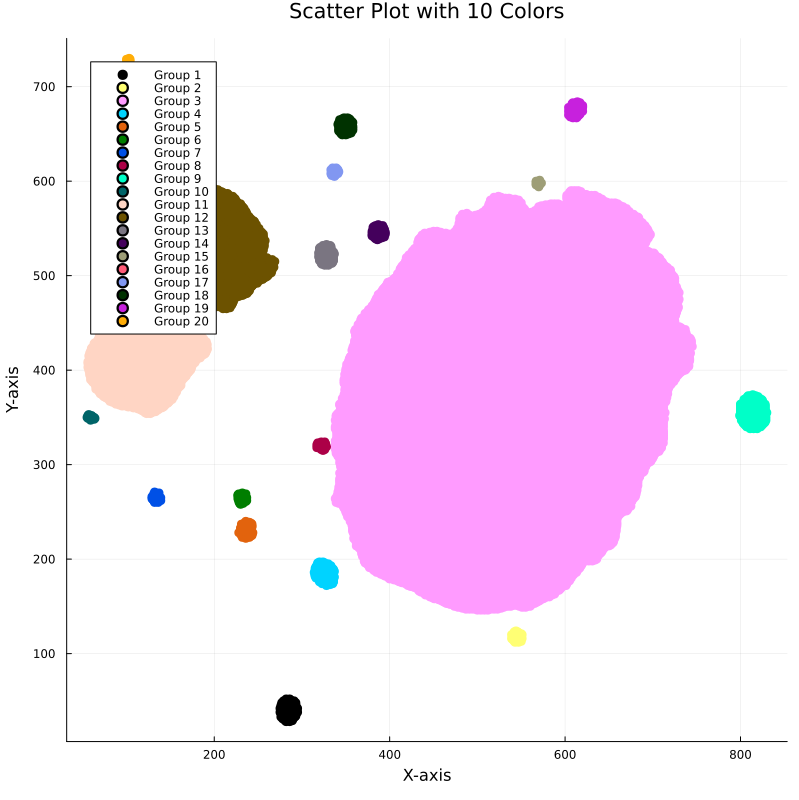

In [116]:
# Plot the points with the colors of the clusters
N_int = 4
x = points[2, :][1:N_int:end]
y = points[1, :][1:N_int:end]
groups = result.assignments[1:N_int:end]

# Define a palette of 10 colors
N_clusters = maximum(groups)
colors = distinguishable_colors(N_clusters)

# Plot each group with its specific color
scatter(x, y,
    color=colors[groups], label="", legend=false,
    # remove black border
    markerstrokewidth=0,
    markersize=5
)

# Add a legend for the colors
for i in 1:N_clusters
    scatter!([], [], marker=:circle, color=colors[i], label="Group $i")
end

# Display the plot
plot!(legend=:topleft,
    title="Scatter Plot with 10 Colors",
    xlabel="X-axis",
    ylabel="Y-axis",
    size=(800, 800),
)

## Edge detector

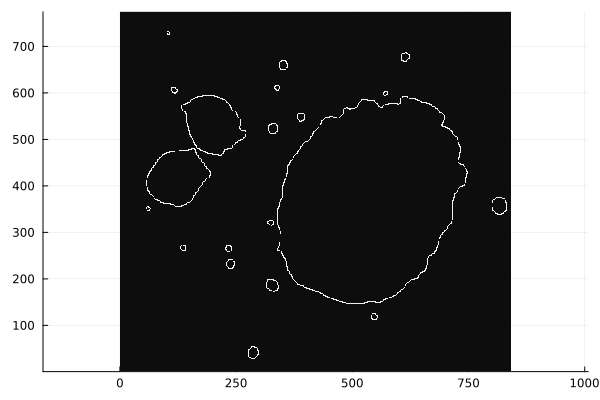

In [117]:
d1 = 0.3
d2 = 4.00

# Detect edges
edges, gradients, laplacians = canny_edge_detector(Matrix{Float64}(th_img), d1, d2)
heatmap(edges, color=:grays, aspect_ratio=1, cbar=false)

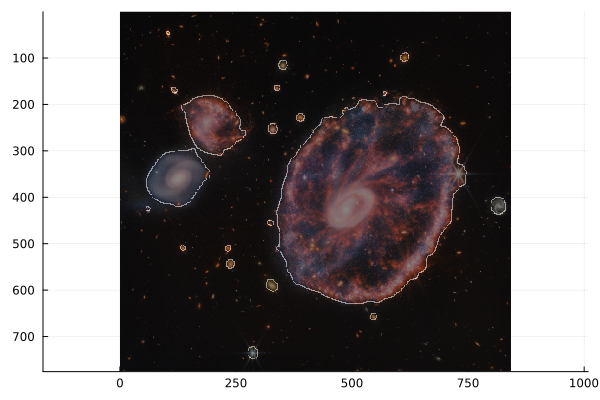

In [121]:
# overlay the edges on top of the original image
edges = edges[end:-1:1, :]
plt_res = heatmap(image, aspect_ratio=1, cbar=false)
heatmap!(plt_res, edges, color=:grays, aspect_ratio=1, cbar=false, alpha=0.5)
savefig(plt_res, "cartwheel_edges.png")
display(plt_res)

In [123]:
groups

40577-element Vector{Int64}:
  1
  1
  1
  1
  1
  1
  1
  1
  1
  1
  ⋮
 19
 20
 20
 20
 20
 20
 20
 20
 20